<a href="https://colab.research.google.com/github/RajamannarAanjaram/EVA-6/blob/master/Object_Detection_DETR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
! pip3 install torchtext==0.7.0
! pip3 install torchvision==0.6.0

     |████████████████████████████████| 4.5 MB 13.3 MB/s 
     |████████████████████████████████| 1.2 MB 70.7 MB/s 
  Attempting uninstall: torchtext
    Found existing installation: torchtext 0.10.0
    Uninstalling torchtext-0.10.0:
      Successfully uninstalled torchtext-0.10.0
     |████████████████████████████████| 6.6 MB 14.5 MB/s 
     |████████████████████████████████| 752.0 MB 6.5 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102


In [2]:
! git clone https://github.com/RajamannarAanjaram/TSAI-Assignment.git

Cloning into 'TSAI-Assignment'...
remote: Enumerating objects: 724, done.
remote: Counting objects: 100% (724/724), done.
remote: Compressing objects: 100% (635/635), done.
remote: Total 724 (delta 145), reused 575 (delta 64), pack-reused 0
Receiving objects: 100% (724/724), 34.15 MiB | 18.55 MiB/s, done.
Resolving deltas: 100% (145/145), done.


In [3]:
%cd TSAI-Assignment/'14 DETR'/

/content/TSAI-Assignment/14 DETR


In [4]:
ls

 detr/   experiments/  'Object Detection DETR.ipynb'   README.md   VIA2COCO/


In [5]:
 ## Downloading the data and decompressing it.
 ## The image annotations are done in VIA format and we are converting it into COCO format using the VIA2COCO dir. 
 
 %cd VIA2COCO/

/content/TSAI-Assignment/14 DETR/VIA2COCO


### Data Loading

In [93]:
# download, decompress the data
! wget https://github.com/matterport/Mask_RCNN/releases/download/v2.1/balloon_dataset.zip
! unzip balloon_dataset.zip > /dev/null

In [92]:
ls

balloon/             convert.py  LICENSE    __pycache__/
balloon_dataset.zip  getArea.py  __MACOSX/  README.md


In [9]:
# Choose whether to start indexing categories with 0 or with 1.

# NB: convention in COCO dataset is such that the 1st class (person) has ID n°1.

# NB²: this is why we chose to set to 1 the default value of `first_class_index`
# in `via2coco.convert()`.
first_class_index = 0

In [63]:
import torch, torchvision, warnings, os
import torchvision.transforms as T

warnings.filterwarnings('ignore')
torch.set_grad_enabled(False)

print("Torch Version:- ",torch.__version__)
print("Torchvision Version:- ",torchvision.__version__)
print("GPU attached:-  ", torch.cuda.is_available())

Torch Version:-  1.5.0
Torchvision Version:-  0.6.0
GPU attached:-   True


We expect the directory structure to be the following:
```
path/to/coco/
├ annotations/  # JSON annotations
│  ├ annotations/custom_train.json
│  └ annotations/custom_val.json
├ train2017/    # training images
└ val2017/      # validation images
```

In [ ]:
import convert as via2coco

data_path = '/content/TSAI-Assignment/14 DETR/VIA2COCO'

for keyword in ['train', 'val']:
    input_dir = data_path + 'balloon/' + keyword + '/'
    input_json = input_dir + 'via_region_data.json'
    categories = ['balloon']
    super_categories = ['N/A']
    output_json = input_dir + 'custom_' + keyword + '.json'

    print('Converting {} from VIA format to COCO format'.format(input_json))

    coco_dict = via2coco.convert(
        imgdir=input_dir,
        annpath=input_json,
        categories=categories,
        super_categories=super_categories,
        output_file_name=output_json,
        first_class_index=first_class_index,
    )

In [34]:
! mkdir -p /content/TSAI-Assignment/'14 DETR'/data/custom/annotations/
! mkdir -p /content/TSAI-Assignment/'14 DETR'/data/custom/train2017/
! mkdir -p /content/TSAI-Assignment/'14 DETR'/data/custom/val2017/

! mv /content/TSAI-Assignment/'14 DETR'/VIA2COCO/balloon/train/custom_train.json /content/TSAI-Assignment/'14 DETR'/data/custom/annotations/custom_train.json
! mv /content/TSAI-Assignment/'14 DETR'/VIA2COCO/balloon/val/custom_val.json /content/TSAI-Assignment/'14 DETR'/data/custom/annotations/custom_val.json
! mv /content/TSAI-Assignment/'14 DETR'/VIA2COCO/balloon/train/*.jpg /content/TSAI-Assignment/'14 DETR'/data/custom/train2017/
! mv /content/TSAI-Assignment/'14 DETR'/VIA2COCO/balloon/val/*.jpg /content/TSAI-Assignment/'14 DETR'/data/custom/val2017/

In [58]:
dataDir='/content/TSAI-Assignment/14 DETR/data/custom/'
dataType='train2017'
annFile='{}annotations/custom_train.json'.format(dataDir)

In [59]:
print("Train data:- ", len(os.listdir(os.path.join(dataDir+'/train2017/'))))
print("Test data:- ", len(os.listdir(os.path.join(dataDir+'/val2017/'))))

Train data:-  61
Test data:-  13


## Check the dataset after it was pre-processed for fine-tuning

To verify the data loading is correct, let's visualize the annotations of randomly selected samples in the training set:
-   Demo of COCO API: https://github.com/cocodataset/cocoapi/blob/master/PythonAPI/pycocoDemo.ipynb

In [69]:
%matplotlib inline
import pycocotools.coco as coco
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

In [72]:
# initialize COCO api for instance annotations
coco=COCO(annFile)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [73]:
# display COCO categories and supercategories
cats = coco.loadCats(coco.getCatIds())

nms=[cat['name'] for cat in cats]
print('Categories: {}'.format(nms))

nms = set([cat['supercategory'] for cat in cats])
print('Super-categories: {}'.format(nms))

Categories: ['balloon']
Super-categories: {'N/A'}


In [74]:
# load and display image
catIds = coco.getCatIds(catNms=['balloon'])
imgIds = coco.getImgIds(catIds=catIds)

In [79]:
img_id = imgIds[np.random.randint(0,len(imgIds))]
print('Image n°{}'.format(img_id))

Image n°58


In [80]:
img = coco.loadImgs(img_id)[0]
img

{'coco_url': '',
 'date_captured': '2021-08-13 07:52:27.552931',
 'file_name': '126700562_8e27720147_b.jpg',
 'flickr_url': '',
 'height': 768,
 'id': 58,
 'license': 1,
 'width': 1024}

In [81]:
## Image file name

img_name = '%s/%s/%s'%(dataDir, dataType, img['file_name'])
print('Image name: {}'.format(img_name))

Image name: /content/TSAI-Assignment/14 DETR/data/custom//train2017/126700562_8e27720147_b.jpg


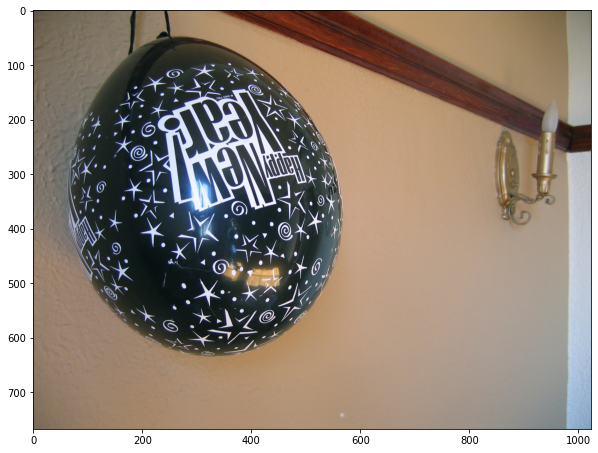

In [82]:
I = io.imread(img_name)
plt.figure()
plt.imshow(I)

In [83]:
annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds)
anns = coco.loadAnns(annIds)

In [84]:
## annotation for above image

anns

[{'area': 4788.000000000008,
  'bbox': [64, 38, 507, 602],
  'category_id': 0,
  'id': 225,
  'image_id': 58,
  'iscrowd': 0,
  'segmentation': [[156,
    101,
    129,
    137,
    95,
    195,
    71,
    264,
    64,
    336,
    66,
    398,
    87,
    466,
    124,
    531,
    197,
    600,
    251,
    623,
    334,
    640,
    414,
    621,
    466,
    593,
    511,
    547,
    557,
    460,
    571,
    381,
    562,
    299,
    538,
    240,
    502,
    184,
    460,
    135,
    409,
    98,
    347,
    65,
    297,
    49,
    256,
    48,
    244,
    38,
    233,
    42,
    226,
    49,
    226,
    54,
    198,
    69,
    156,
    101]]}]

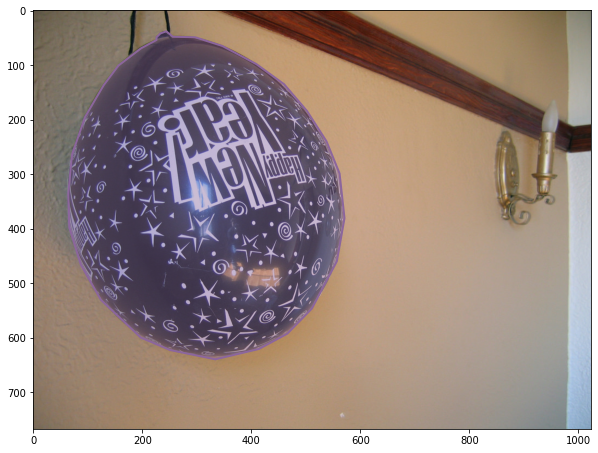

In [85]:
# load and display instance annotations
plt.imshow(I)
coco.showAnns(anns, draw_bbox=False)

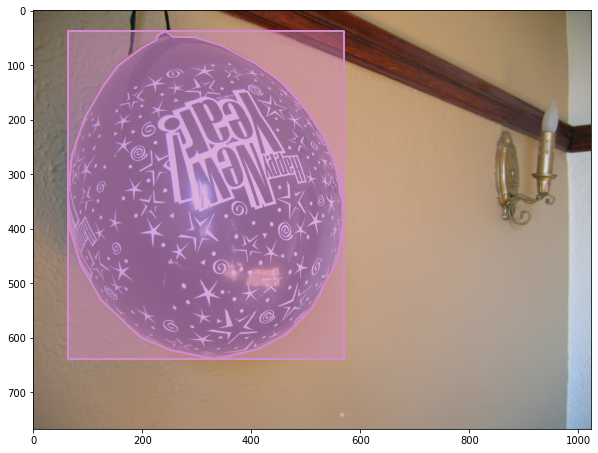

In [86]:
plt.imshow(I)
coco.showAnns(anns, draw_bbox=True)

In [95]:
%cd /content/TSAI-Assignment/'14 DETR'/detr

/content/TSAI-Assignment/14 DETR/detr


In [96]:
ls

d2/         engine.py   main.py    requirements.txt      tox.ini
datasets/   hubconf.py  models/    run_with_submitit.py  util/
Dockerfile  LICENSE     README.md  test_all.py


In [97]:
assert(first_class_index in [0, 1])

if first_class_index == 0:

  # There is one class, balloon, with ID n°0.

  num_classes = 1

  finetuned_classes = [
      'balloon',
  ]

  # The `no_object` class will be automatically reserved by DETR with ID equal
  # to `num_classes`, so ID n°1 here.  

else:

  # There is one class, balloon, with ID n°1.
  #
  # However, DETR assumes that indexing starts with 0, as in computer science,
  # so there is a dummy class with ID n°0.
  # Caveat: this dummy class is not the `no_object` class reserved by DETR.

  num_classes = 2

  finetuned_classes = [
      'N/A', 'balloon',
  ]

  # The `no_object` class will be automatically reserved by DETR with ID equal
  # to `num_classes`, so ID n°2 here.

print('First class index: {}'.format(first_class_index))  
print('Parameter num_classes: {}'.format(num_classes))
print('Fine-tuned classes: {}'.format(finetuned_classes))

First class index: 0
Parameter num_classes: 1
Fine-tuned classes: ['balloon']


In [98]:
# Get pretrained weights
checkpoint = torch.hub.load_state_dict_from_url(
            url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
            map_location='cpu',
            check_hash=True)

# Remove class weights
del checkpoint["model"]["class_embed.weight"]
del checkpoint["model"]["class_embed.bias"]

# Save
torch.save(checkpoint,
           'detr-r50_no-class-head.pth')

Downloading: "https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth" to /root/.cache/torch/checkpoints/detr-r50-e632da11.pth


In [99]:
# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [100]:
# for output bounding box post-processing
# Get coordinates (x0, y0, x1, y0) from model output (x, y, w, h)

def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

In [101]:
# Scale box from [0,1]x[0,1] to [0, width]x[0, height]

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [102]:
pwd

'/content/TSAI-Assignment/14 DETR/detr'

In [105]:
! python main.py --dataset_file "custom"  --coco_path "/content/TSAI-Assignment/14 DETR/data/custom/" \
  --output_dir "/content/TSAI-Assignment/14 DETR/outputs" \
  --resume "detr-r50_no-class-head.pth" \
  --num_classes $num_classes \
  --epochs 300

Streaming output truncated to the last 5000 lines.
Epoch: [100]  [10/30]  eta: 0:00:04  lr: 0.000100  class_error: 10.00  loss: 2.9402 (3.1076)  loss_ce: 0.0325 (0.0515)  loss_bbox: 0.1109 (0.1423)  loss_giou: 0.2151 (0.2761)  loss_ce_0: 0.1113 (0.1295)  loss_bbox_0: 0.1877 (0.1947)  loss_giou_0: 0.3348 (0.3371)  loss_ce_1: 0.0491 (0.0866)  loss_bbox_1: 0.1396 (0.1550)  loss_giou_1: 0.3092 (0.2802)  loss_ce_2: 0.0535 (0.0718)  loss_bbox_2: 0.1339 (0.1553)  loss_giou_2: 0.2820 (0.2968)  loss_ce_3: 0.0397 (0.0523)  loss_bbox_3: 0.1268 (0.1453)  loss_giou_3: 0.2843 (0.2878)  loss_ce_4: 0.0316 (0.0496)  loss_bbox_4: 0.1108 (0.1328)  loss_giou_4: 0.1787 (0.2630)  loss_ce_unscaled: 0.0325 (0.0515)  class_error_unscaled: 0.0000 (4.4805)  loss_bbox_unscaled: 0.0222 (0.0285)  loss_giou_unscaled: 0.1075 (0.1381)  cardinality_error_unscaled: 0.0000 (0.7273)  loss_ce_0_unscaled: 0.1113 (0.1295)  loss_bbox_0_unscaled: 0.0375 (0.0389)  loss_giou_0_unscaled: 0.1674 (0.1685)  cardinality_error_0_unsca

### Model Training Plots

In [106]:
from util.plot_utils import plot_logs
from pathlib import Path

log_directory = [Path('/content/TSAI-Assignment/14 DETR/outputs/')]

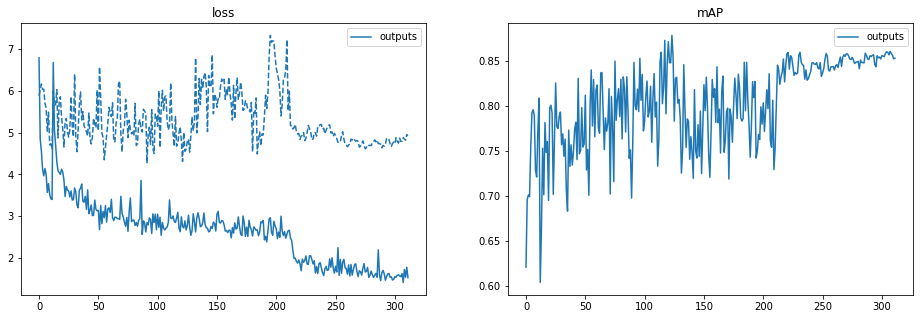

In [107]:
fields_of_interest = (
    'loss',
    'mAP',
    )

plot_logs(log_directory,
          fields_of_interest)

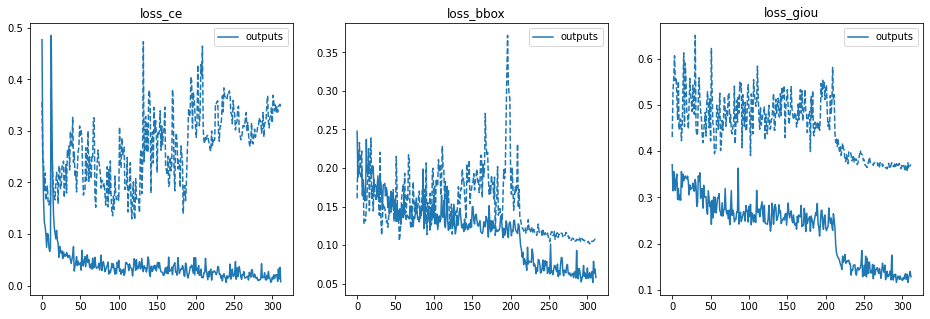

In [108]:
fields_of_interest = (
    'loss_ce',
    'loss_bbox',
    'loss_giou',
    )

plot_logs(log_directory,
          fields_of_interest)

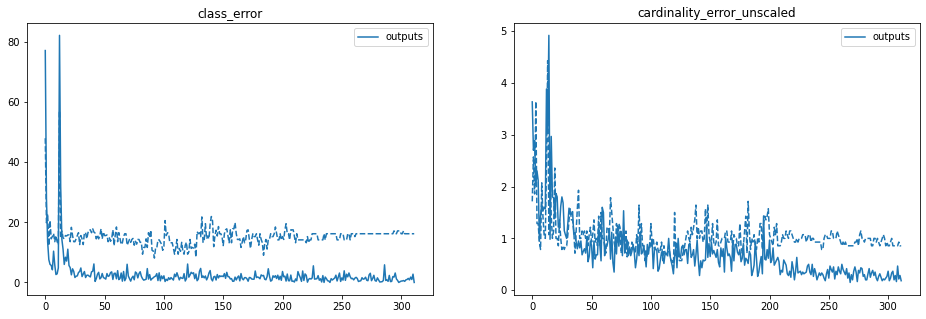

In [109]:
fields_of_interest = (
    'class_error',
    'cardinality_error_unscaled',
    )

plot_logs(log_directory,
          fields_of_interest)   

Load The **fine tuned** model

In [110]:
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=num_classes)

Downloading: "https://github.com/facebookresearch/detr/archive/master.zip" to /root/.cache/torch/hub/master.zip
Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


In [111]:
checkpoint = torch.load('/content/TSAI-Assignment/14 DETR/outputs/checkpoint.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval()

DETR(
  (transformer): Transformer(
    (encoder): TransformerEncoder(
      (layers): ModuleList(
        (0): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): Linear(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (1): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): Linear(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Drop

In [118]:
def filter_bboxes_from_outputs(outputs,
                               threshold=0.7):
  
  # keep only predictions with confidence above threshold
  probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  probas_to_keep = probas[keep]

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
  
  return probas_to_keep, bboxes_scaled

In [119]:
def plot_finetuned_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
      for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
          cl = p.argmax()
          text = f'{finetuned_classes[cl]}: {p[cl]:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [120]:
def run_worflow(my_image, my_model,threshold):
  # mean-std normalize the input image (batch-size: 1)
  img = transform(my_image).unsqueeze(0)

  # propagate through the model
  outputs = my_model(img)

  for threshold in [threshold]:
    
    probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                              threshold=threshold)

    plot_finetuned_results(my_image,
                           probas_to_keep, 
                           bboxes_scaled)

In [123]:
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

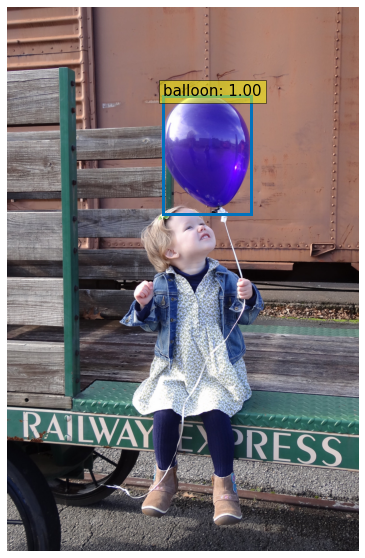

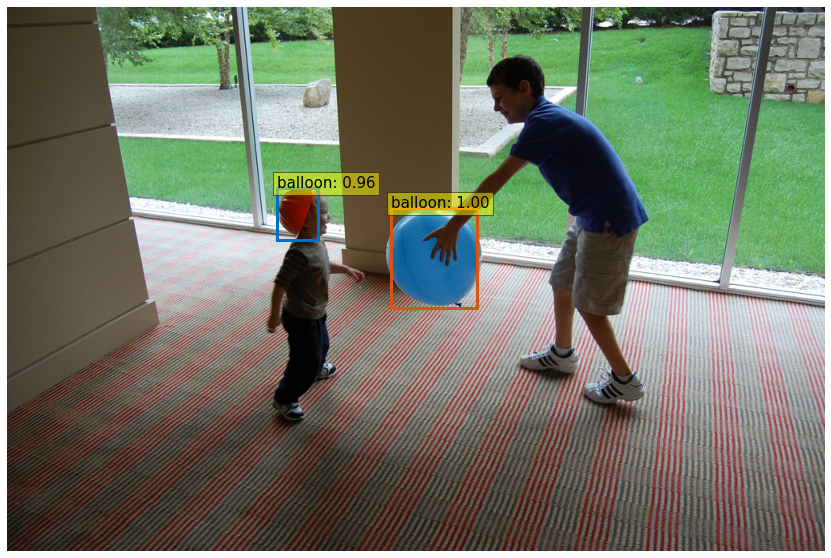

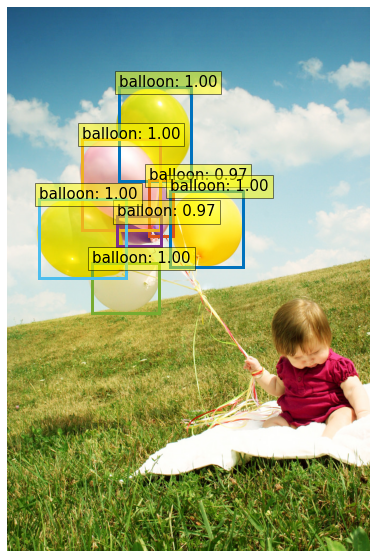

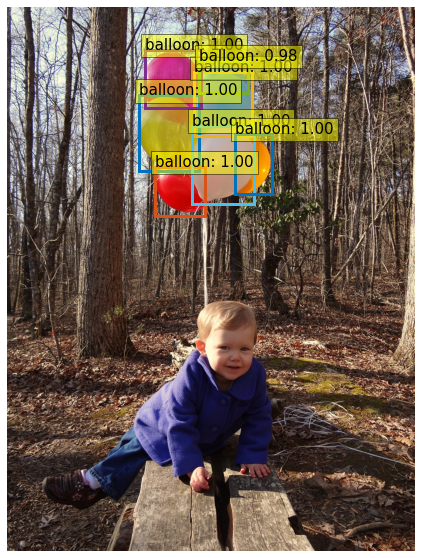

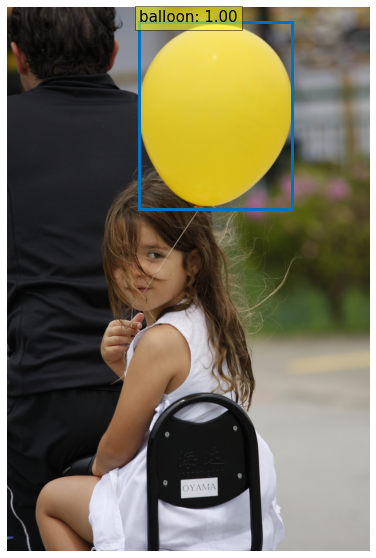

...

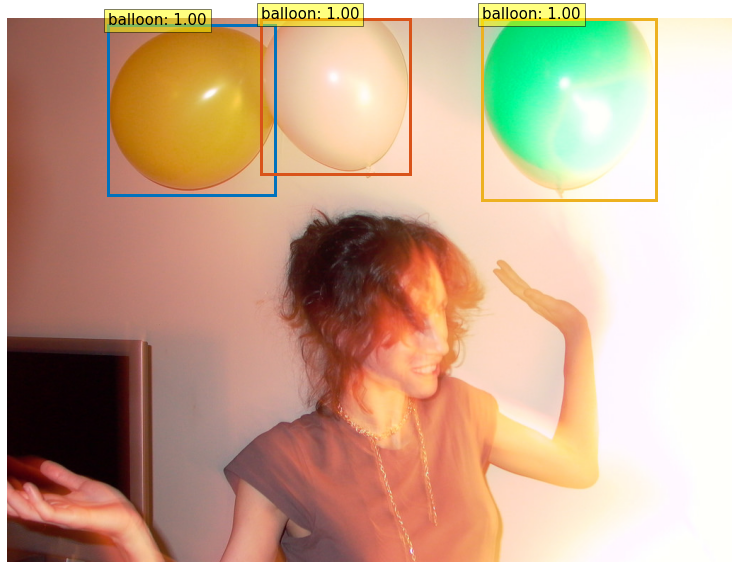

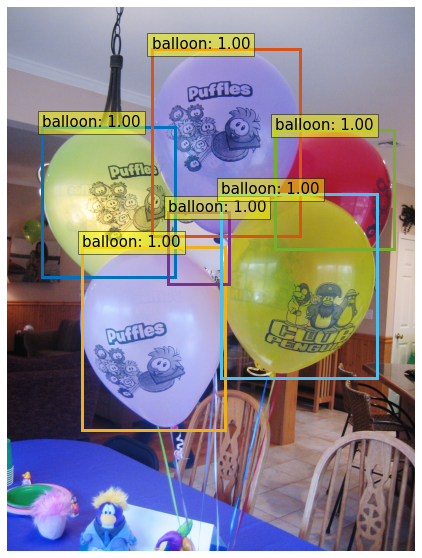

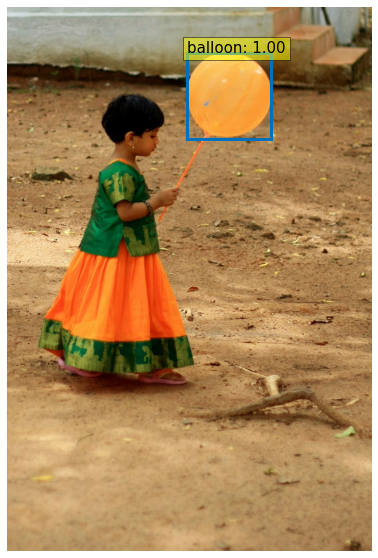

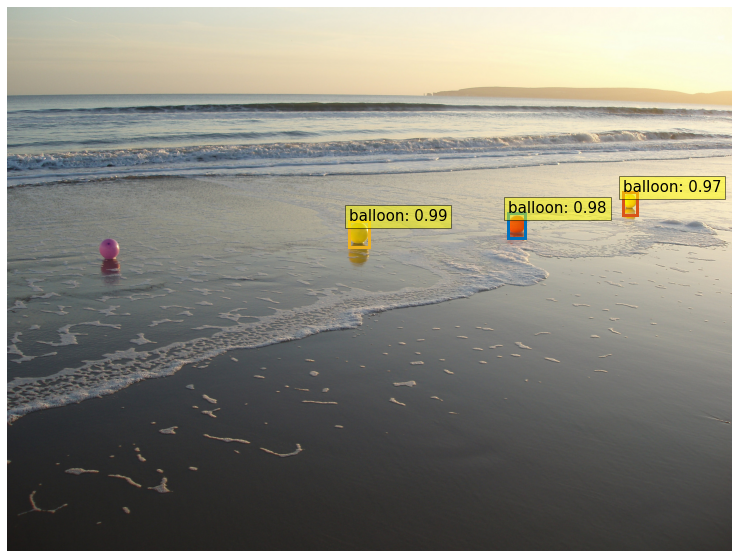

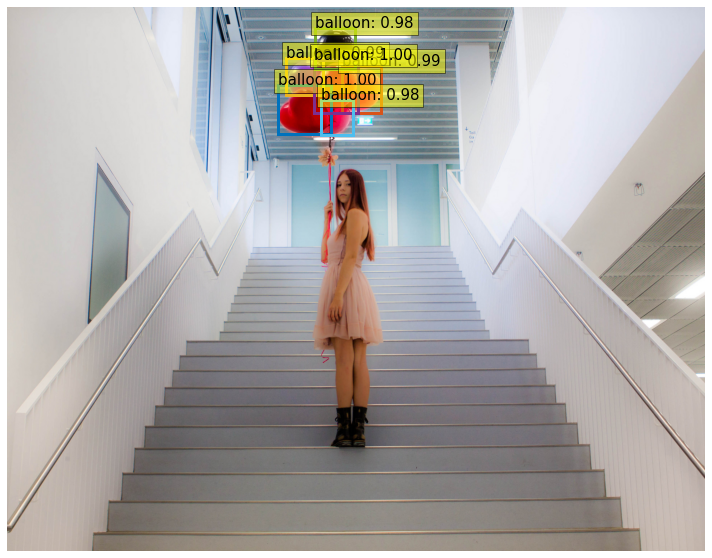

In [131]:
for i in os.listdir(os.path.join(dataDir+'/val2017/')):
    img_name = dataDir+'/val2017/'+i
    im = Image.open(img_name)
    ## Model 
    run_worflow(im,  model, 0.9)
    plt.show()

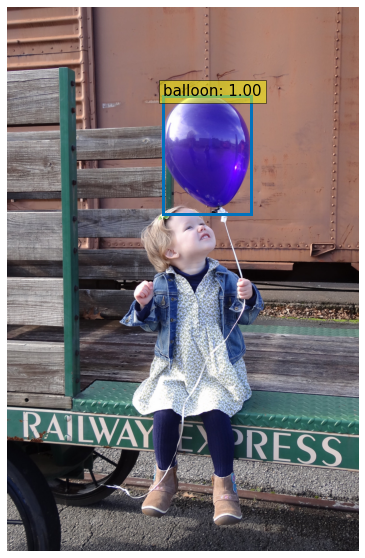

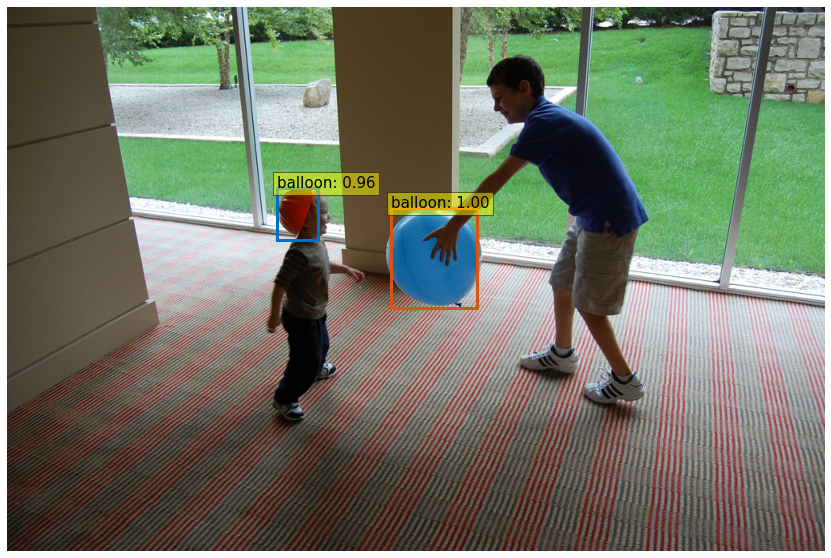

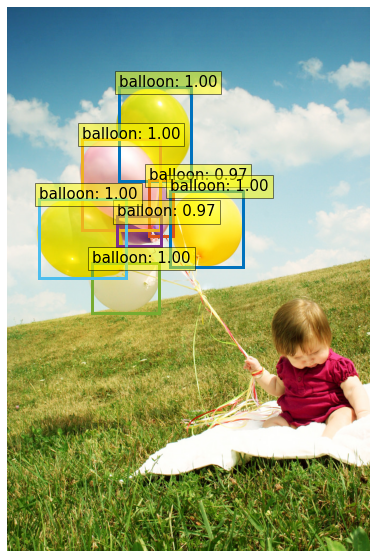

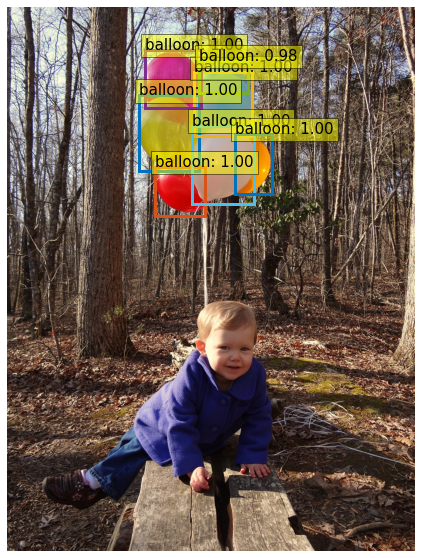

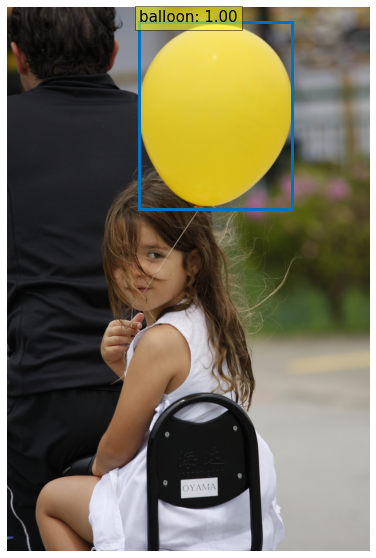

...

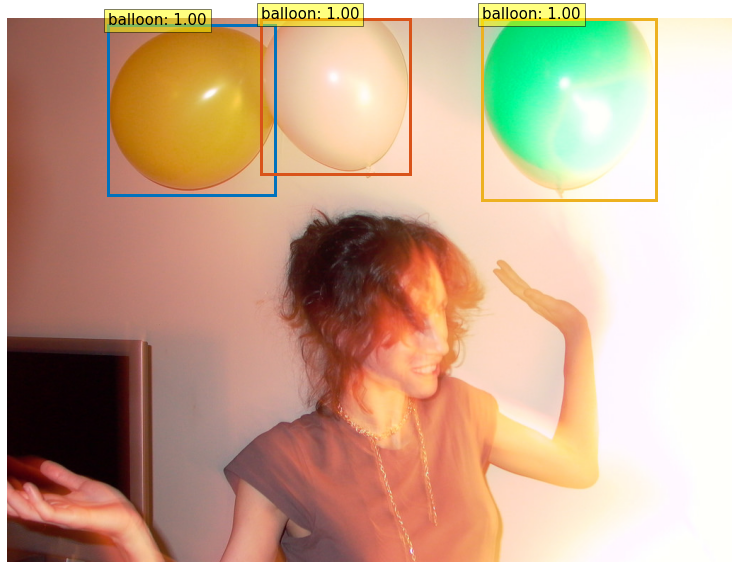

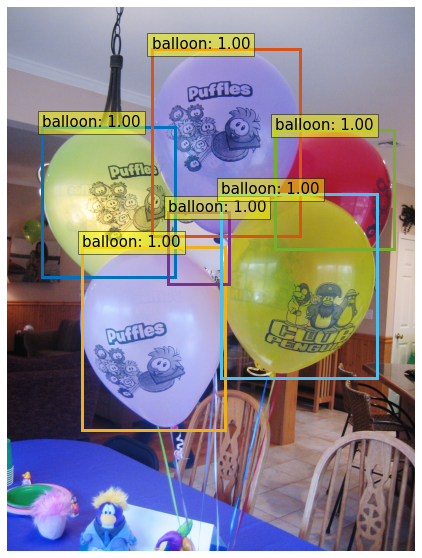

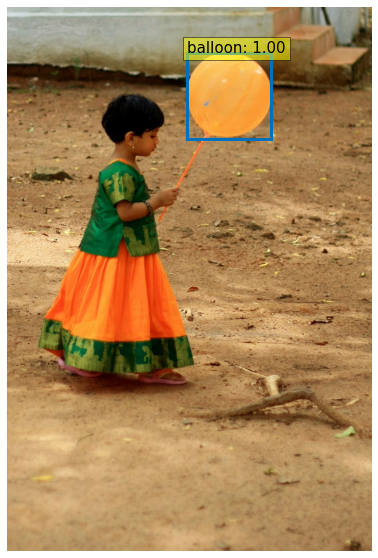

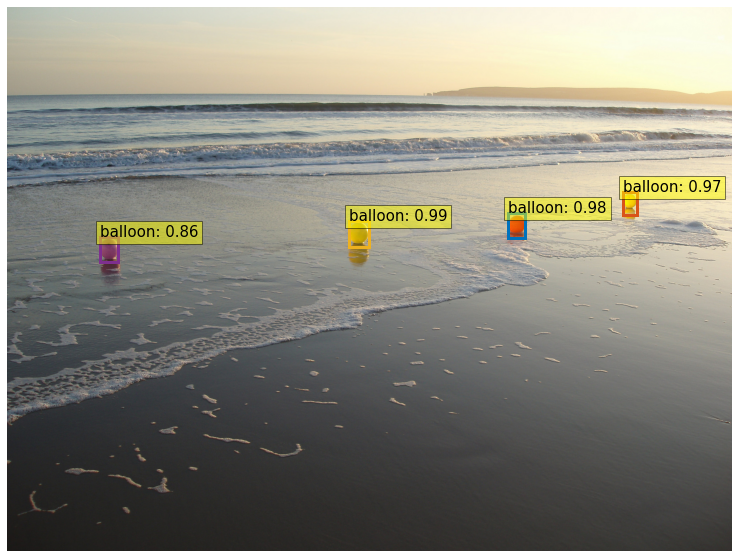

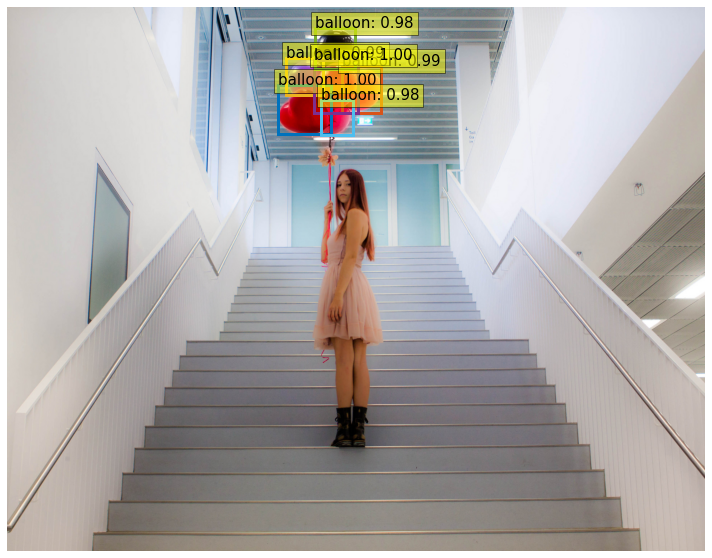

In [132]:
for i in os.listdir(os.path.join(dataDir+'/val2017/')):
    img_name = dataDir+'/val2017/'+i
    im = Image.open(img_name)
    ## Model 
    run_worflow(im,  model, 0.7)
    plt.show()

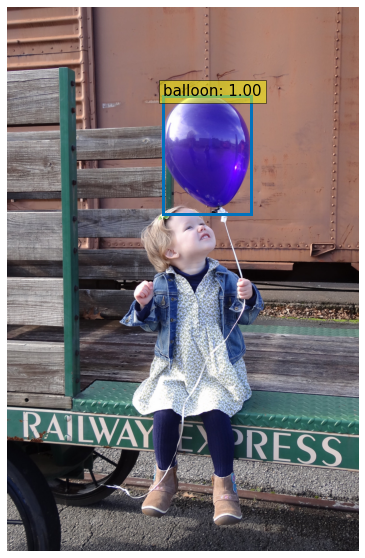

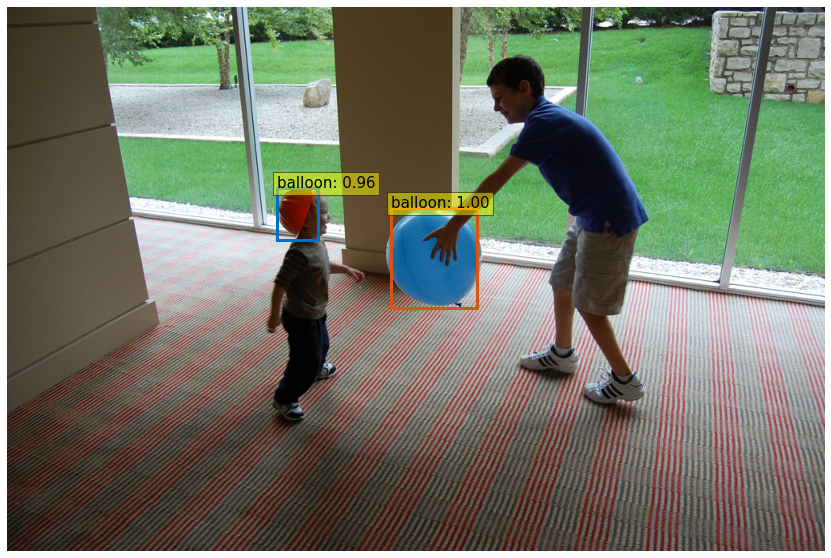

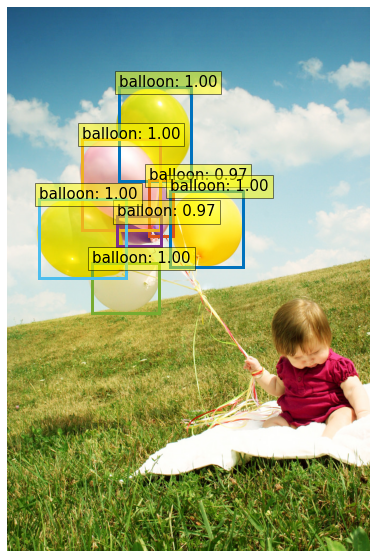

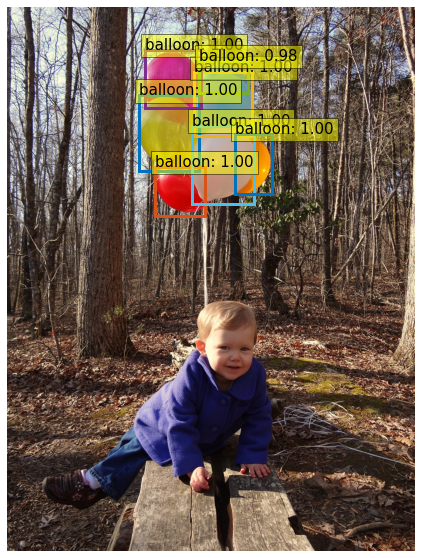

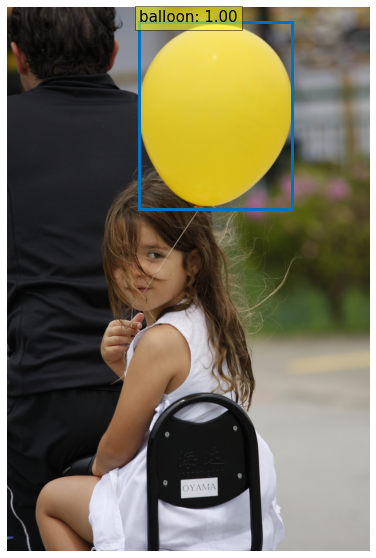

...

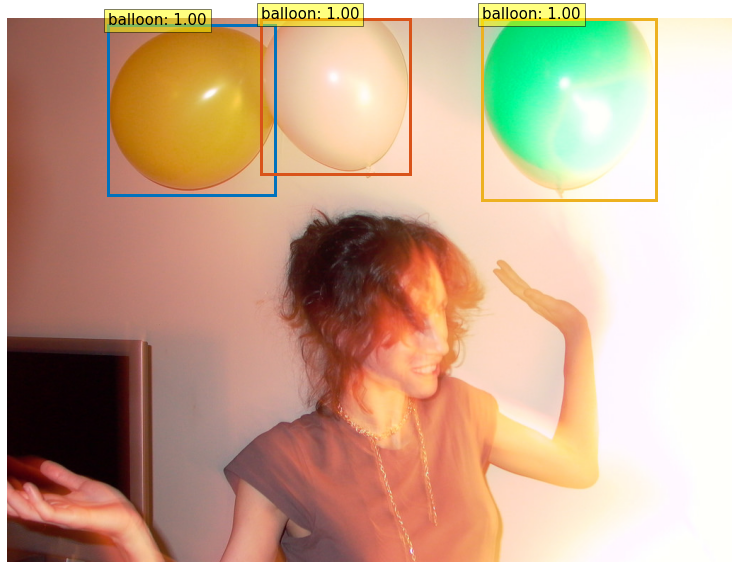

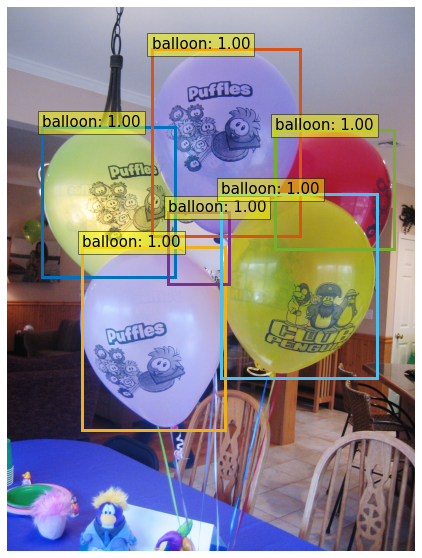

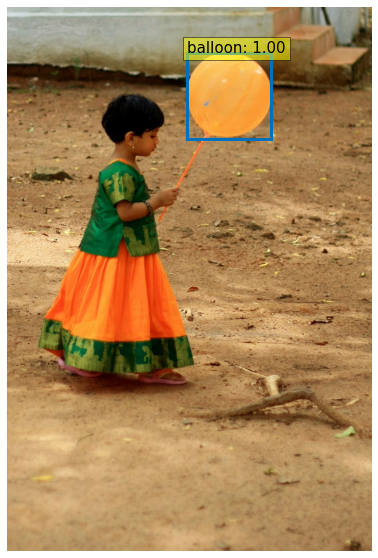

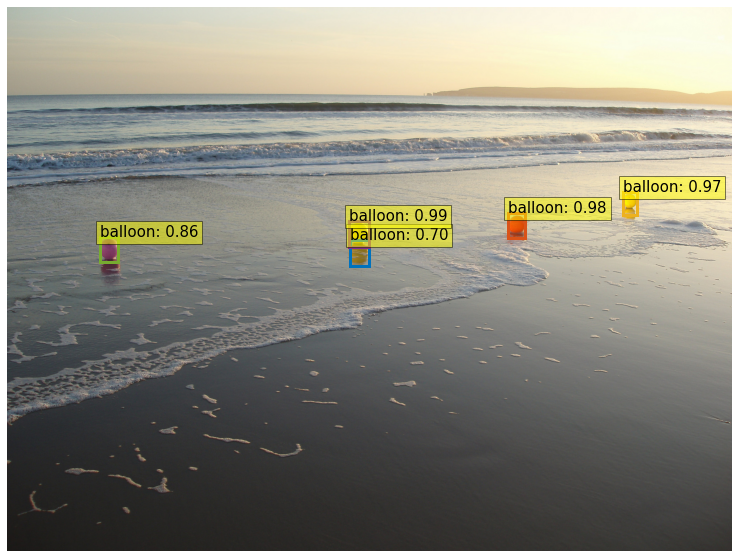

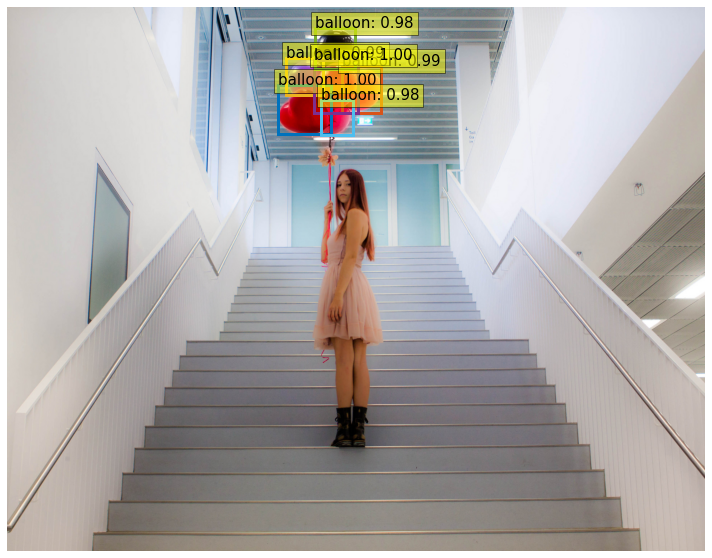

In [133]:
for i in os.listdir(os.path.join(dataDir+'/val2017/')):
    img_name = dataDir+'/val2017/'+i
    im = Image.open(img_name)
    ## Model 
    run_worflow(im,  model, 0.5)
    plt.show()